In [1]:
import cv2
import glob
import math
import matplotlib.image as mpimg
import matplotlib.pyplot as plt
import numpy as np
import re
from moviepy.editor import VideoFileClip
from scipy.signal import gaussian

%matplotlib inline

CALIBRATION_FILES = 'camera_cal/calibration*.jpg'
FIND_LANE_LINE_SOBEL_KERNEL = 3
FIND_LANE_LINE_S_CHANNEL_THRESHOLDS = (170, 255)
FIND_LANE_LINE_MAGNITUDE_X_THRESHOLDS = (20, 255)
FIND_LANE_LINE_MAGNITUDE_Y_THRESHOLDS = (30, 255)
FIND_LANE_LINE_MAGNITUDE_X_Y_THRESHOLDS = (30, 255)
FIND_LANE_LINE_ANGLE_THRESHOLDS = (0.7, 1.3)
CROP_AREA = [(81, 716), (554, 459), (735, 456), (1213, 713)]
WARP_SOURCE = [(267, 713), (589, 461), (707, 460), (1152, 712)]
WARP_DESTINATION = [(300, 720), (300, 0), (900, 0), (900, 720)]
CENTROID_WINDOW_WIDTH = 80
CENTROID_WINDOW_HEIGHT = 80
CENTROID_MARGIN = 50
CENTROID_MIN_PIXEL_REQUIRED = 50
Y_METERS_PER_PIXEL = 30.0 / 720
X_METERS_PER_PIXEL = 3.7 / 700

In [2]:
CALIBRATION_MATRIX = None
CALIBRATION_DIST_COEFFICIENTS = None
PERPECTIVE_TRANSFORM_MATRIX = None
INVERSE_PERPECTIVE_TRANSFORM_MATRIX = None

In [3]:
def calibrate_camera(p_image_files, p_number_corners):

    """
    Calibray camera from calibration images
    """
    # 2D points in image plan
    image_points = []
    # 3D points in real world space
    object_points = []

    # Prepare object points like (0, 0, 0), (1, 0, 0), (2, 0, 0), ..., (7, 5, 0)
    for image_file in p_image_files:
        (nx, ny) = p_number_corners[int(re.findall('\d+', image_file)[0]) - 1]
        objp = np.zeros((nx * ny, 3), np.float32)
        objp[:, :2] = np.mgrid[0:nx, 0:ny].T.reshape(-1, 2)

        image = cv2.imread(image_file)
        grayscale_image = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)

        ret, corners = cv2.findChessboardCorners(grayscale_image, (nx, ny), None)

        if ret:
            image_points.append(corners)
            object_points.append(objp)

            cv2.drawChessboardCorners(image, (nx, ny), corners, ret)
            plt.figure()
            plt.title(image_file)
            plt.imshow(image)
        else:
            print('Unlable to find chess board corner of %s with nx as %d and ny as %d' % (image_file, nx, ny))

    ret, mtx, dist, rvecs, tvecs = cv2.calibrateCamera(object_points, image_points, grayscale_image.shape[ : : -1], None, None)
    
    assert ret, 'Unable to calibrate the camer'
    
    global CALIBRATION_MATRIX, CALIBRATION_DIST_COEFFICIENTS
    CALIBRATION_MATRIX, CALIBRATION_DIST_COEFFICIENTS = mtx, dist

Unlable to find chess board corner of camera_cal/calibration4.jpg with nx as 9 and ny as 6
Unlable to find chess board corner of camera_cal/calibration5.jpg with nx as 9 and ny as 5


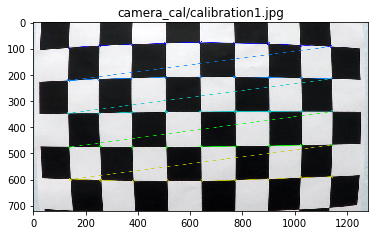

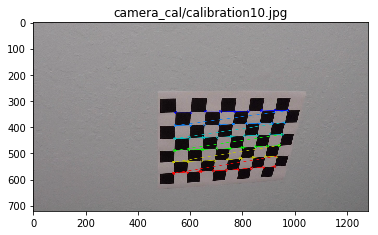

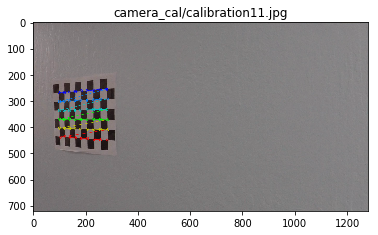

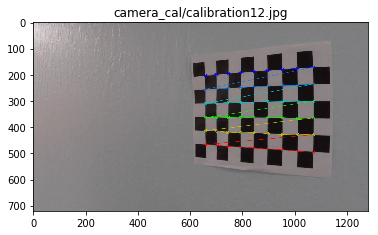

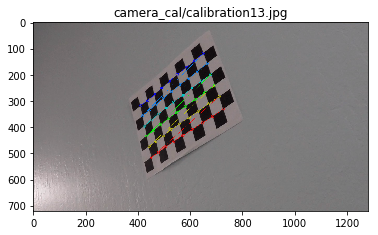

...

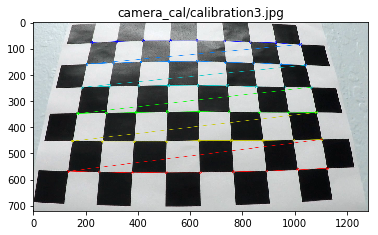

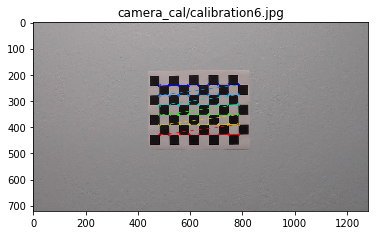

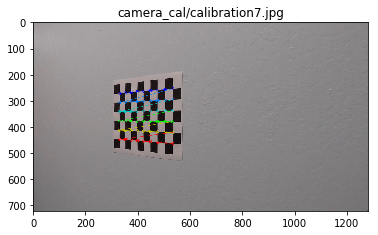

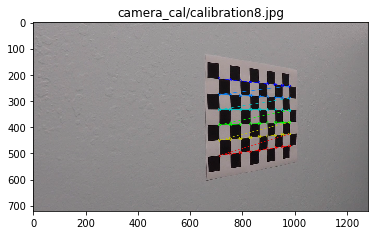

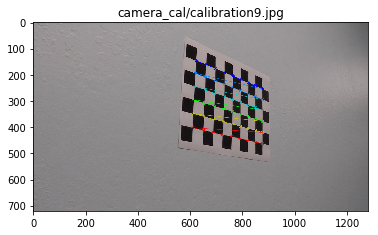

In [4]:
# Calibrate camera using the calibrate images

calibration_image_files = glob.glob(CALIBRATION_FILES)
number_calibration_corners = [ \
    (9, 5), (9, 6), (9, 6), (9, 6), (9, 5), \
    (9, 6), (9, 6), (9, 6), (9, 6), (9, 6), \
    (9, 6), (9, 6), (9, 6), (9, 6), (9, 6), \
    (9, 6), (9, 6), (9, 6), (9, 6), (9, 6)]

calibrate_camera(calibration_image_files, number_calibration_corners)

In [5]:
def undistort(p_image):
    return cv2.undistort(p_image, CALIBRATION_MATRIX, CALIBRATION_DIST_COEFFICIENTS, None, CALIBRATION_MATRIX)

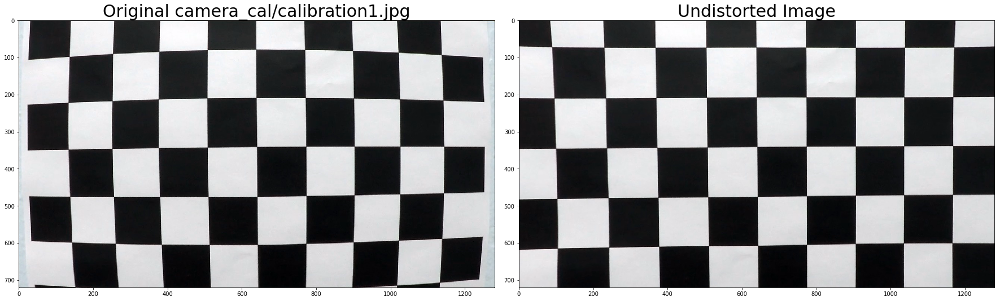

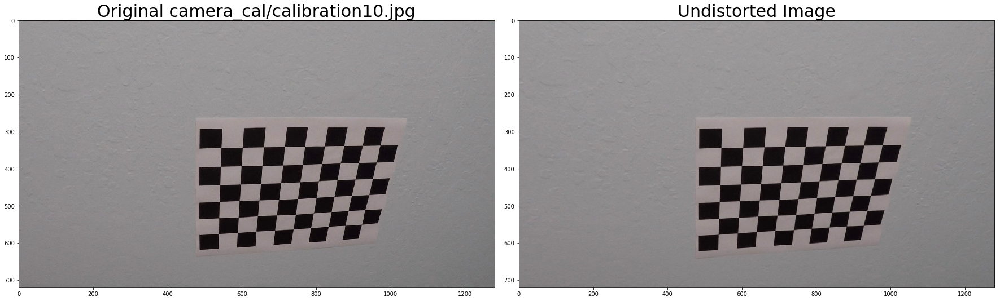

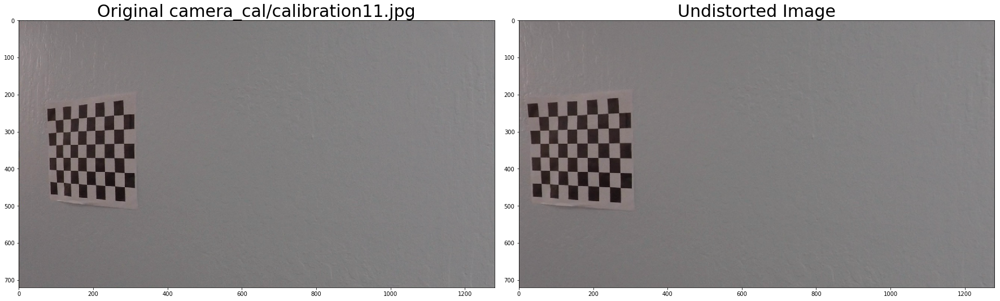

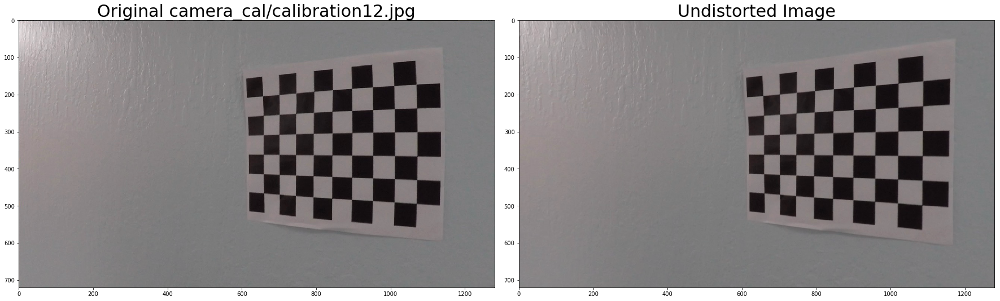

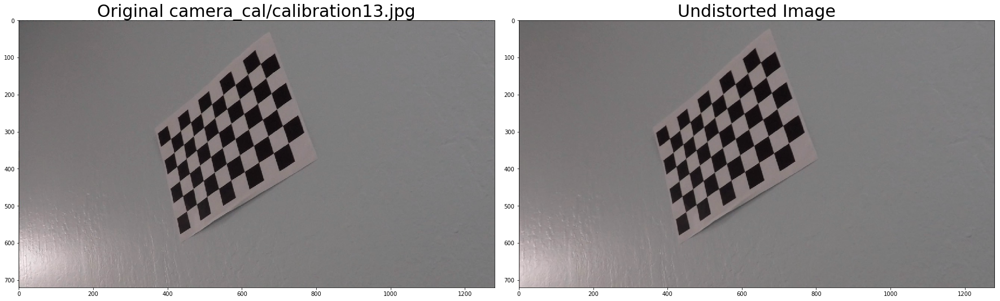

...

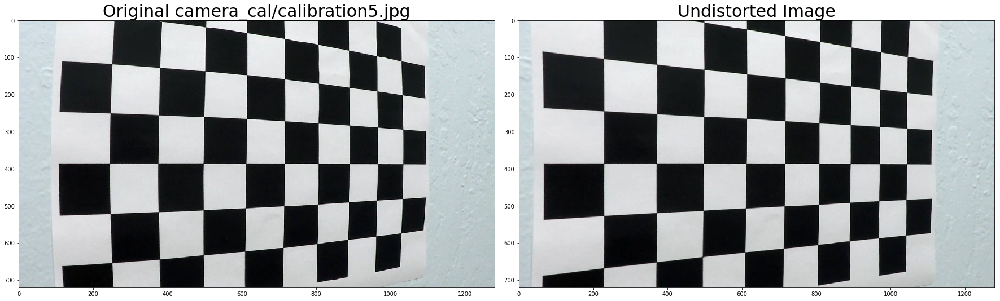

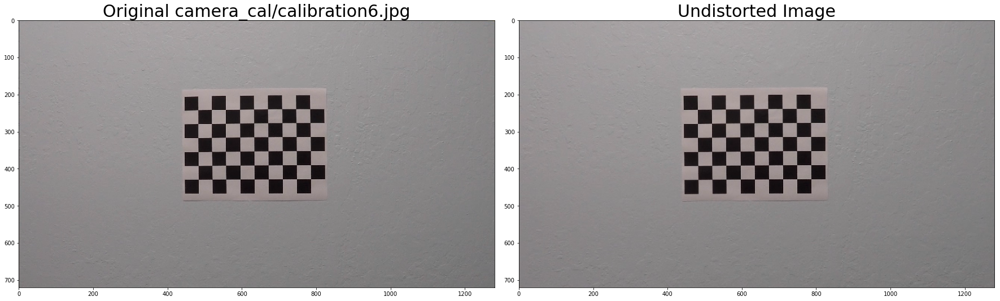

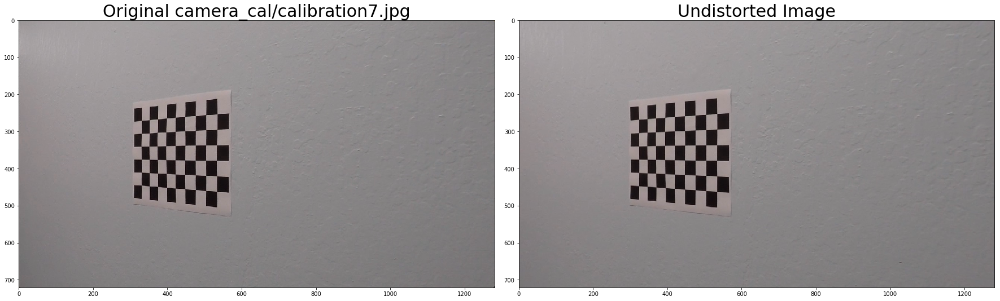

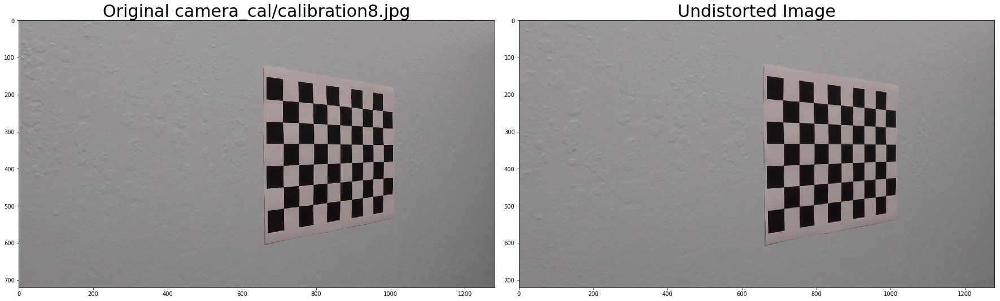

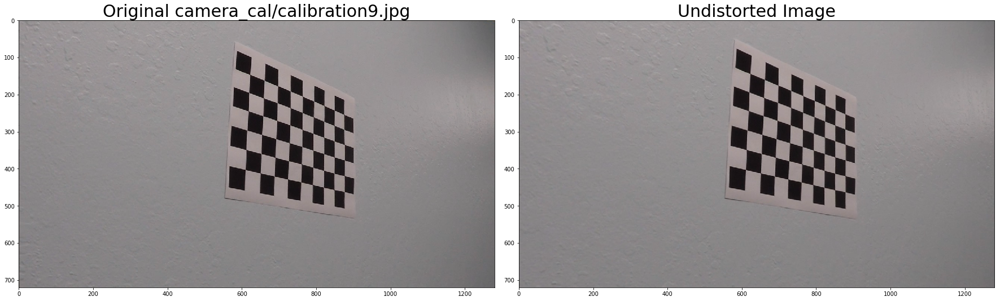

In [6]:
# Apply calibration maxtrix to undistort calibration images

calibration_image_files = glob.glob(CALIBRATION_FILES)

for calibration_image_file in calibration_image_files:
    calibration_image = cv2.imread(calibration_image_file)
    undistorted_calibration_image = undistort(calibration_image)        

    plt.figure()
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
    f.tight_layout()
    ax1.imshow(calibration_image)
    ax1.set_title('Original %s' % calibration_image_file, fontsize=30)
    ax2.imshow(undistorted_calibration_image)
    ax2.set_title('Undistorted Image', fontsize=30)
    plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)

In [7]:
def scale_and_filter(p_input, p_thresholds):
    binary = np.zeros_like(p_input)
    binary[(p_input >= p_thresholds[0]) & (p_input <= p_thresholds[1])] = 1
    return binary

def find_lane_lines(p_image):   
    hls = cv2.cvtColor(p_image, cv2.COLOR_BGR2HLS)
    s_channel_binary = scale_and_filter(p_input=hls[:, :, 2], p_thresholds=FIND_LANE_LINE_S_CHANNEL_THRESHOLDS)

    gray_image = cv2.cvtColor(p_image, cv2.COLOR_BGR2GRAY)

    gradient_x = cv2.Sobel(gray_image, cv2.CV_64F, 1, 0, ksize=FIND_LANE_LINE_SOBEL_KERNEL)
    magnitude_x = np.absolute(gradient_x)
    magnitude_x_binary = \
        scale_and_filter( \
            p_input=magnitude_x, \
            p_thresholds=(FIND_LANE_LINE_MAGNITUDE_X_THRESHOLDS[0] * np.max(magnitude_x) / 255, 
                          FIND_LANE_LINE_MAGNITUDE_X_THRESHOLDS[1] * np.max(magnitude_x) / 255))

    gradient_y = cv2.Sobel(gray_image, cv2.CV_64F, 0, 1, ksize=FIND_LANE_LINE_SOBEL_KERNEL)
    magnitude_y = np.absolute(gradient_y)
    magnitude_y_binary = \
        scale_and_filter( \
            p_input=magnitude_y, \
            p_thresholds=(FIND_LANE_LINE_MAGNITUDE_Y_THRESHOLDS[0] * np.max(magnitude_y) / 255, 
                          FIND_LANE_LINE_MAGNITUDE_Y_THRESHOLDS[1] * np.max(magnitude_y) / 255))

    magnitude_x_y = np.sqrt(gradient_x ** 2 + gradient_y**2)
    magnitude_x_y_binary = \
        scale_and_filter( \
            p_input=magnitude_x_y, 
            p_thresholds=(FIND_LANE_LINE_MAGNITUDE_X_Y_THRESHOLDS[0] * np.max(magnitude_x_y) / 255, 
                          FIND_LANE_LINE_MAGNITUDE_X_Y_THRESHOLDS[1] * np.max(magnitude_x_y) / 255))

    angle = np.arctan2(magnitude_y, magnitude_x)
    angle_binary = scale_and_filter(p_input=angle, p_thresholds=FIND_LANE_LINE_ANGLE_THRESHOLDS)
    
    combined = np.zeros_like(angle_binary)
    combined[(s_channel_binary == 1) |
             (((magnitude_x_binary == 1) & (magnitude_y_binary == 1)) |
              ((magnitude_x_y_binary == 1) & (angle_binary == 1)))] = int(1)
    
    return combined

In [8]:
def crop(p_image):
    region_select = np.zeros_like(p_image)
    
    cv2.fillConvexPoly(region_select, np.array(CROP_AREA, np.int32), 1)
    
    return np.multiply(p_image, region_select)

In [9]:
def warp(p_image):
    global PERPECTIVE_TRANSFORM_MATRIX
    if PERPECTIVE_TRANSFORM_MATRIX is None:
        src = np.float32(WARP_SOURCE)
        dst = np.float32(WARP_DESTINATION)
        
        PERPECTIVE_TRANSFORM_MATRIX = cv2.getPerspectiveTransform(src, dst)
    
    return \
        cv2.warpPerspective(p_image, PERPECTIVE_TRANSFORM_MATRIX, (p_image.shape[1], p_image.shape[0]), flags=cv2.INTER_LINEAR)

In [10]:
def find_centroids(p_warped_image):
    # Store the (left,right) window centroid positions per level
    window_centroids = [] 
    
    # Create our window template that we will use for convolutions
    window = gaussian(CENTROID_WINDOW_WIDTH, 0.5) 
    
    # First find the two starting positions for the left and right lane 
    # by using np.sum to get the vertical image slice
    # and then np.convolve the vertical image slice with the window template 
    
    # Sum quarter bottom of image to get slice, could use a different ratio
    l_sum = np.sum( \
        p_warped_image[int(p_warped_image.shape[0] / 2) : , : int(p_warped_image.shape[1] / 2)], axis=0)
 
    # Use window_width/2 as offset because convolution signal reference is at right side of window, not center of window
    offset = CENTROID_WINDOW_WIDTH / 2
    l_center = np.argmax(np.convolve(window, l_sum)) - offset
    
    r_sum = np.sum( \
        p_warped_image[int(p_warped_image.shape[0] / 2) : , int(p_warped_image.shape[1] / 2) : ], axis=0)
    r_center = \
        np.argmax(np.convolve(window, r_sum)) - offset + int(p_warped_image.shape[1] / 2)
    
    # Add what we found for the first layer
    window_centroids.append((l_center, r_center))
    
    l_lane_indices = []
    r_lane_indices = []
    nonzero = p_warped_image.nonzero()
    nonzero_y = np.array(nonzero[0])
    nonzero_x = np.array(nonzero[1])
    
    l_centroid_margin = CENTROID_MARGIN
    r_centroid_margin = CENTROID_MARGIN
    # Go through each layer looking for max pixel locations
    for level in range(1, (int)(p_warped_image.shape[0] / CENTROID_WINDOW_HEIGHT)):
        # convolve the window into the vertical slice of the image
        top_index = int(p_warped_image.shape[0] - (level + 1) * CENTROID_WINDOW_HEIGHT)
        bottom_index = int(p_warped_image.shape[0] - level * CENTROID_WINDOW_HEIGHT)
        image_layer = \
                np.sum(p_warped_image[top_index : bottom_index, : ], axis=0)
        conv_signal = np.convolve(window, image_layer)

        # Add what we found for that layer
        window_centroids.append([None, None])
        
        # Find the best left centroid by using past left center as a reference
        l_min_index = int(max(l_center + offset - l_centroid_margin, 0))
        l_max_index = int(min(l_center + offset + l_centroid_margin, p_warped_image.shape[1]))

        current_l_lane_indices = \
            ((nonzero_y < bottom_index) & 
             (nonzero_y >= top_index) & 
             (nonzero_x >= l_min_index) & 
             (nonzero_x < l_max_index)).nonzero()[0]
        if len(current_l_lane_indices) > CENTROID_MIN_PIXEL_REQUIRED:
            l_lane_indices.append(current_l_lane_indices)
            l_center = np.argmax(conv_signal[l_min_index : l_max_index]) + l_min_index - offset
            window_centroids[-1][0] = l_center
            l_centroid_margin = CENTROID_MARGIN
        else:
            l_centroid_margin += 20
            
        # Find the best right centroid by using past right center as a reference
        r_min_index = int(max(r_center + offset - r_centroid_margin, 0))
        r_max_index = int(min(r_center + offset + r_centroid_margin, p_warped_image.shape[1]))
        
        current_r_lane_indices = \
            ((nonzero_y < bottom_index) & 
             (nonzero_y >= top_index) & 
             (nonzero_x >= r_min_index) & 
             (nonzero_x < r_max_index)).nonzero()[0]
        if len(current_r_lane_indices) > CENTROID_MIN_PIXEL_REQUIRED:
            r_lane_indices.append(current_r_lane_indices)
            r_center = np.argmax(conv_signal[r_min_index : r_max_index]) + r_min_index - offset
            window_centroids[-1][1] = r_center
            r_centroid_margin = CENTROID_MARGIN
        else:
            r_centroid_margin += 20
        
    l_lane_indices = np.concatenate(l_lane_indices)
    r_lane_indices = np.concatenate(r_lane_indices)
    
    l_x = nonzero_x[l_lane_indices]
    l_y = nonzero_y[l_lane_indices] 
    r_x = nonzero_x[r_lane_indices]
    r_y = nonzero_y[r_lane_indices] 
        
    return window_centroids, l_x, l_y, r_x, r_y

In [11]:
def window_mask(p_image, p_center, p_level):
    output = np.zeros_like(p_image)
    output[ \
        int(p_image.shape[0] - (p_level + 1) * CENTROID_WINDOW_HEIGHT) : \
            int(p_image.shape[0] - p_level * CENTROID_WINDOW_HEIGHT), \
        max(0, int(p_center - CENTROID_WINDOW_WIDTH / 2)) : \
            min(int(p_center + CENTROID_WINDOW_WIDTH / 2), p_image.shape[1])] = 1
    return output

def draw_centroids(p_warped_image, p_centroids):
    # Points used to draw all the left and right windows
    l_points = np.zeros_like(p_warped_image)
    r_points = np.zeros_like(p_warped_image)

    # Go through each level and draw the windows
    for level in range(0, len(p_centroids)):
        # Window_mask is a function to draw window areas
        if p_centroids[level][0] is not None:
            l_mask = window_mask(p_warped_image, p_centroids[level][0], level)
            # Add graphic points from window mask here to total pixels found 
            l_points[(l_points == 255) | ((l_mask == 1) ) ] = 255
        if p_centroids[level][1] is not None:
            r_mask = window_mask(p_warped_image, p_centroids[level][1], level)
            r_points[(r_points == 255) | ((r_mask == 1) ) ] = 255

    # Draw the results
    template = np.array(r_points + l_points, np.uint8) # add both left and right window pixels together
    zero_channel = np.zeros_like(template) # create a zero color channel
    template = np.array(cv2.merge((zero_channel, template, zero_channel)), np.uint8) # make window pixels green
    # making the original road pixels 3 color channels
    warpage = \
        np.array(cv2.merge((p_warped_image, p_warped_image, p_warped_image)), np.uint8) * 255

    output = cv2.addWeighted(warpage, 1, template, 0.2, 0.0) # overlay the orignal road image with window results
 
    return output

In [12]:
def draw_fit_lines_on_warped_image(p_warped_image, p_left_lane_x, p_left_lane_y, p_right_lane_x, p_right_lane_y):
    left_fit = np.polyfit(p_left_lane_y, p_left_lane_x, 2)
    right_fit = np.polyfit(p_right_lane_y, p_right_lane_x, 2)
    
    ploty = np.array(np.linspace(0, p_warped_image.shape[0]-1, p_warped_image.shape[0]), np.int32)

    left_fit_x = np.array(left_fit[0] * ploty**2 + left_fit[1] * ploty + left_fit[2], np.int32)

    left_max_index = [i for i, v in enumerate(left_fit_x) if int(v) < p_warped_image.shape[1]][-1]

    right_fit_x = np.array(right_fit[0] * ploty**2 + right_fit[1] * ploty + right_fit[2], np.int32)
    right_max_index = [i for i, v in enumerate(right_fit_x) if int(v) < p_warped_image.shape[1]][-1]
    
    ouput = p_warped_image.copy()
    
    ouput[ploty[:left_max_index], left_fit_x[:left_max_index]] = (255, 0, 0)
    ouput[ploty[:right_max_index], right_fit_x[:right_max_index]] = (255, 0, 0)
    
    return ouput

In [13]:
def unwarp(p_image):
    global INVERSE_PERPECTIVE_TRANSFORM_MATRIX
    if INVERSE_PERPECTIVE_TRANSFORM_MATRIX is None:
        src = np.float32(WARP_DESTINATION)
        dst = np.float32(WARP_SOURCE)
        
        INVERSE_PERPECTIVE_TRANSFORM_MATRIX = cv2.getPerspectiveTransform(src, dst)
    
    return \
        cv2.warpPerspective( \
            p_image, INVERSE_PERPECTIVE_TRANSFORM_MATRIX, (p_image.shape[1], p_image.shape[0]), flags=cv2.INTER_LINEAR)

In [14]:
def draw_fit_lines_on_binary_image(p_shape, p_left_lane_x, p_left_lane_y, p_right_lane_x, p_right_lane_y):
    left_fit = np.polyfit(p_left_lane_y, p_left_lane_x, 2)
    right_fit = np.polyfit(p_right_lane_y, p_right_lane_x, 2)
    
    ploty = np.array(np.linspace(0, p_shape[0]-1, p_shape[0]), np.int32)

    left_fit_x = np.array(left_fit[0] * ploty**2 + left_fit[1] * ploty + left_fit[2], np.int32)
    right_fit_x = np.array(right_fit[0] * ploty**2 + right_fit[1] * ploty + right_fit[2], np.int32)
    
    left_max_index = [i for i, v in enumerate(left_fit_x) if int(v) < p_shape[1]][-1]   
    right_max_index = [i for i, v in enumerate(right_fit_x) if int(v) < p_shape[1]][-1]
    max_index = min(left_max_index, right_max_index)
    
    lane_lines = np.zeros(p_shape)
    for extra in range(10):
        lane_lines[ploty[:max_index], left_fit_x[:max_index] + extra] = 1
        lane_lines[ploty[:max_index], right_fit_x[:max_index] + extra] = 1
        
        lane_lines[ploty[:max_index], left_fit_x[:max_index] - extra] = 1
        lane_lines[ploty[:max_index], right_fit_x[:max_index] - extra] = 1
    
    mid_line = np.zeros(p_shape)
    for extra in range(3):
        mid_line[ploty[:max_index], \
                 np.array(left_fit_x[:max_index] * 0.5 + right_fit_x[:max_index] * 0.5, np.int32) + extra] = 1
        mid_line[ploty[:max_index], \
                 np.array(left_fit_x[:max_index] * 0.5 + right_fit_x[:max_index] * 0.5, np.int32) - extra] = 1
    
    color_pane = np.zeros(p_shape)
    for i in range(max_index):
        color_pane[ploty[i], 
                   range(left_fit_x[i], right_fit_x[i])] = 1    
    
    return lane_lines, mid_line, color_pane

In [15]:
def draw_lane_line_on_undistorted_image(p_image, p_left_lane_x, p_left_lane_y, p_right_lane_x, p_right_lane_y):
    lane_lines, mid_line, color_pane = draw_fit_lines_on_binary_image( \
        (p_image.shape[0], p_image.shape[1]), p_left_lane_x, p_left_lane_y, p_right_lane_x, p_right_lane_y)
    
    unwarped_lane_lines = unwarp(lane_lines)
    unwarped_mid_line = unwarp(mid_line)
    unwarped_color_pane = unwarp(color_pane)
    
    rgb_lane_lines = np.array(cv2.merge((unwarped_lane_lines, unwarped_lane_lines, unwarped_lane_lines * 255)), np.uint8)
    rgb_mid_line = np.array(cv2.merge((unwarped_mid_line, unwarped_mid_line, unwarped_mid_line * 255)), np.uint8)
    rgb_color_pane = np.array(cv2.merge((unwarped_color_pane * 100, unwarped_color_pane, unwarped_color_pane)), np.uint8)
    
    merged_image = p_image
    merged_image = cv2.add(merged_image, rgb_lane_lines)
    merged_image = cv2.add(merged_image, rgb_mid_line)
    merged_image = cv2.add(merged_image, rgb_color_pane)
    
    unwarped_mid_line_x, unwarped_mid_line_y = unwarped_mid_line.nonzero()
    mid_line_x = \
        np.mean([x for (x, y) in zip(unwarped_mid_line_x, unwarped_mid_line_y) if y > (p_image.shape[0] * 9 / 10)])

    return merged_image, mid_line_x

In [16]:
def compute_curvatures(p_y_eval, p_left_lane_x, p_left_lane_y, p_right_lane_x, p_right_lane_y):
    # Fit new polynomials to x,y in world space
    left_fit = np.polyfit(p_left_lane_y * Y_METERS_PER_PIXEL, p_left_lane_x * X_METERS_PER_PIXEL, 2)
    right_fit = np.polyfit(p_right_lane_y * Y_METERS_PER_PIXEL, p_right_lane_x * X_METERS_PER_PIXEL, 2)
    
    # Calculate the new radii of curvature
    left_radius = \
        ((1 + (2 * left_fit[0] * p_y_eval * Y_METERS_PER_PIXEL + left_fit[1]) **2) **1.5) / np.absolute(2 * left_fit[0])
    right_radius = \
        ((1 + (2 * right_fit[0] * p_y_eval * Y_METERS_PER_PIXEL + right_fit[1]) **2) **1.5) / np.absolute(2 * right_fit[0])
        
    return left_radius, right_radius

In [17]:
def compute_distance_from_center(p_mid_line_x, p_image_size_x):
    return ((p_image_size_x - p_mid_line_x) * X_METERS_PER_PIXEL)

In [18]:
def process_image(p_image, p_plot=False):
    undistoreted_image = undistort(p_image)
    binary_image = find_lane_lines(undistoreted_image)
    crop_image = crop(binary_image)
    warped_image = warp(crop_image)
    centroids, left_lane_x, left_lane_y, right_lane_x, right_lane_y = find_centroids(warped_image)
    
    if p_plot:
        warped_image_with_drawn_centroids = draw_centroids(warped_image, centroids)
        warped_image_with_drawn_fit_lines = \
            draw_fit_lines_on_warped_image( \
                warped_image_with_drawn_centroids, left_lane_x, left_lane_y, right_lane_x, right_lane_y)

    undistorted_image_with_lane_lines, mid_line_x = \
        draw_lane_line_on_undistorted_image(undistoreted_image, left_lane_x, left_lane_y, right_lane_x, right_lane_y)

    radius = int(np.mean(compute_curvatures(p_image.shape[2], left_lane_x, left_lane_y, right_lane_x, right_lane_y)))
    global RADIUS
    if RADIUS == 0:
        RADIUS = radius
    elif radius is not None:
        RADIUS = RADIUS * 0.9 + radius * 0.1
    
    distance_from_center = compute_distance_from_center(mid_line_x, p_image.shape[1] / 2.0)

    text1 = 'Radius of Curvature = %d(m)' % RADIUS
    text2 = 'Vehicle is %.2fm %s of center' % \
            (math.fabs(distance_from_center), 'right' if (distance_from_center > 0.0) else 'left')

    final_image = \
        cv2.putText(undistorted_image_with_lane_lines, \
                    text1, \
                    (50, 150), \
                    cv2.FONT_HERSHEY_SIMPLEX, \
                    2, \
                    (255,255,255), \
                    thickness=3)
    final_image = \
        cv2.putText(undistorted_image_with_lane_lines, \
                    text2, \
                    (50, 300), \
                    cv2.FONT_HERSHEY_SIMPLEX, \
                    2, \
                    (255,255,255), \
                    thickness=3)
        
    if p_plot:
        image_size = (12, 9)
        plt.figure(figsize=image_size)
        plt.title('Original')
        plt.imshow(p_image, cmap='gray')
        
        plt.figure(figsize=image_size)
        plt.title('Undistorted')
        plt.imshow(undistoreted_image, cmap='gray')
        
        plt.figure(figsize=image_size)
        plt.title('Lane lines')
        plt.imshow(binary_image, cmap='gray')
        
        plt.figure(figsize=image_size)
        plt.title('Crop')
        plt.imshow(crop_image, cmap='gray')
        
        plt.figure(figsize=image_size)
        plt.title('Warp')
        plt.imshow(warped_image, cmap='gray')
        
        plt.figure(figsize=image_size)
        plt.title('Centroid')
        plt.imshow(warped_image_with_drawn_centroids, cmap='gray')
        
        plt.figure(figsize=image_size)
        plt.title('Best fit lines')
        plt.imshow(warped_image_with_drawn_fit_lines, cmap='gray')
        
        plt.figure(figsize=image_size)
        plt.title('Undistorted with lane lines')
        plt.imshow(undistorted_image_with_lane_lines, cmap='gray')
        
        plt.figure(figsize=image_size)
        plt.title('Annotation')
        plt.imshow(final_image, cmap='gray')
        
    return final_image

array([[[200, 153,  97],
        [200, 153,  97],
        [200, 153,  97],
        ..., 
        [196, 149,  87],
        [194, 147,  85],
        [195, 148,  86]],

       [[201, 154,  98],
        [200, 153,  97],
        [200, 153,  97],
        ..., 
        [195, 148,  86],
        [194, 147,  85],
        [195, 148,  86]],

       [[201, 154,  98],
        [201, 154,  98],
        [201, 154,  98],
        ..., 
        [196, 149,  87],
        [195, 148,  86],
        [195, 148,  86]],

       ..., 
       [[105,  93, 108],
        [105,  93, 109],
        [105,  93, 109],
        ..., 
        [ 98, 105, 124],
        [ 99, 106, 125],
        [ 99, 106, 125]],

       [[106,  95, 112],
        [105,  95, 112],
        [104,  94, 111],
        ..., 
        [105, 112, 129],
        [103, 110, 128],
        [103, 110, 127]],

       [[103,  93, 111],
        [101,  92, 110],
        [ 98,  90, 108],
        ..., 
        [103, 110, 127],
        [103, 110, 127],
        [102, 109,

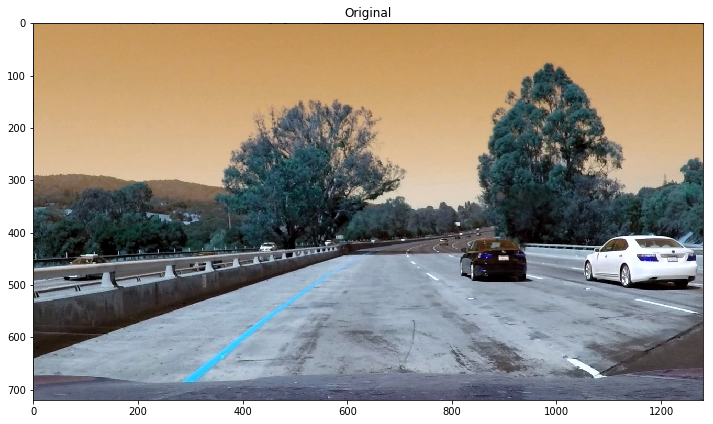

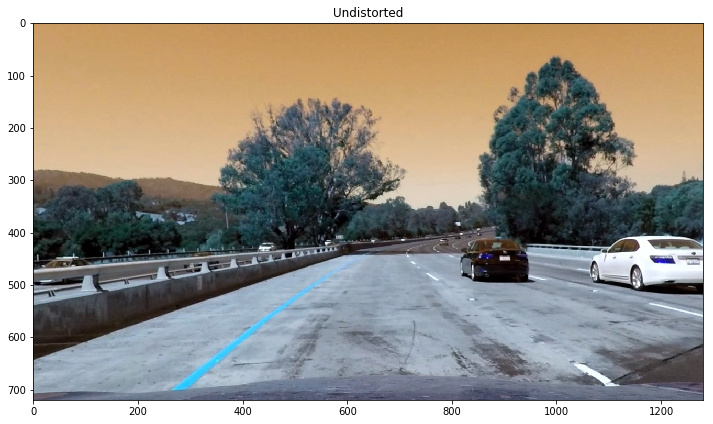

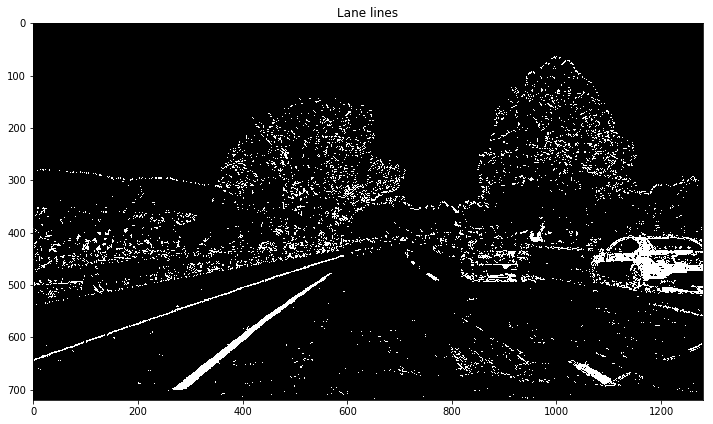

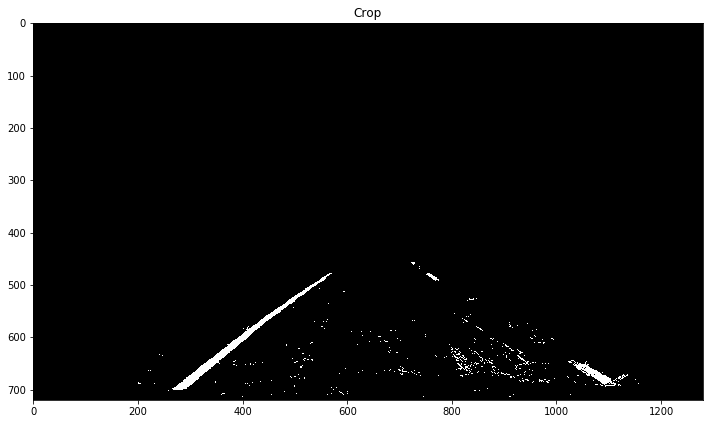

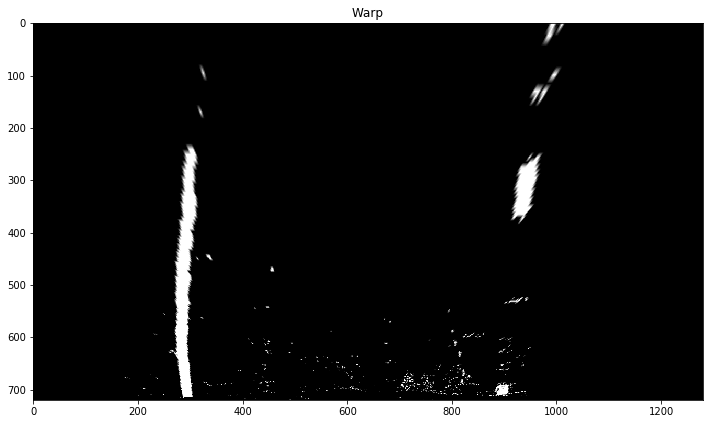

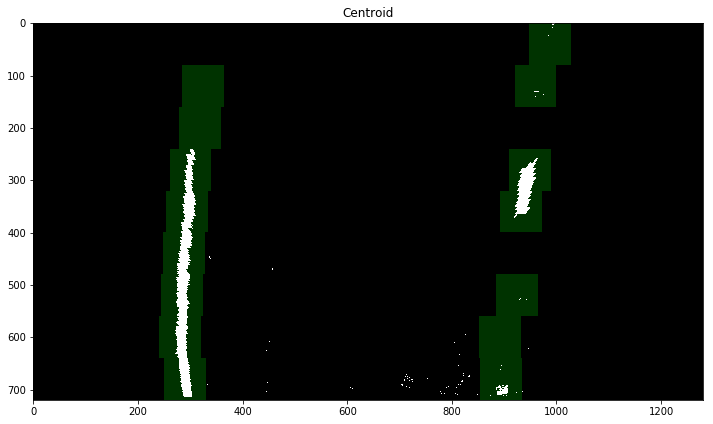

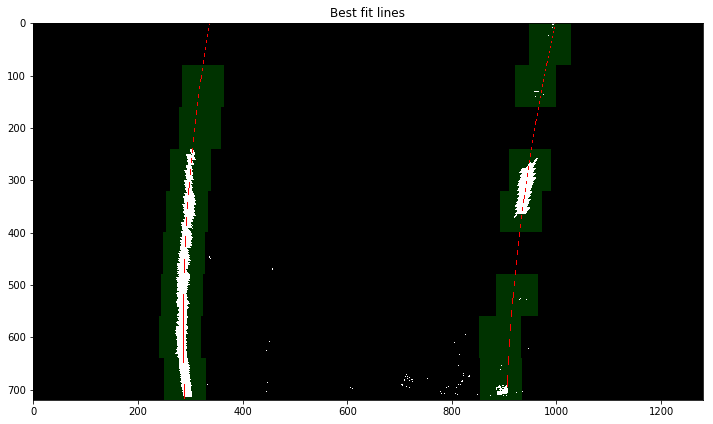

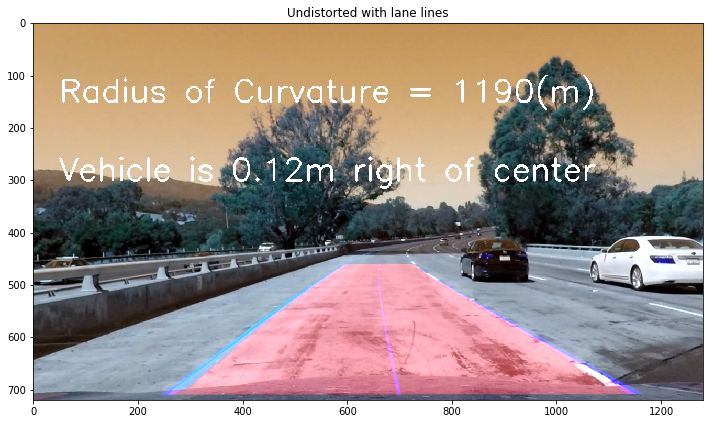

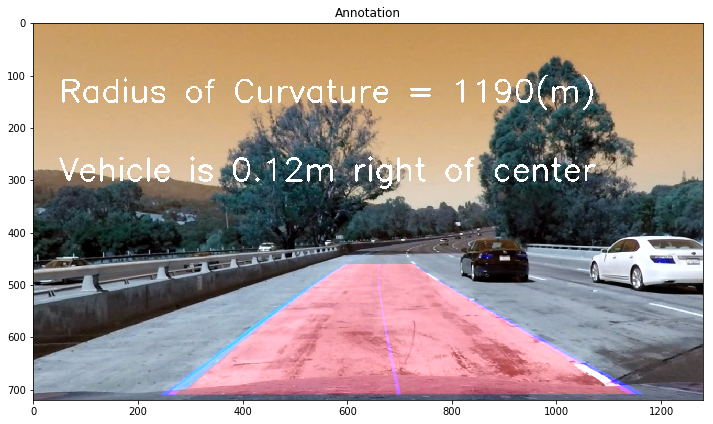

In [19]:
#image_file = 'test_images/straight_lines1.jpg'
#image_file = 'test_images/straight_lines2.jpg'
image_file = 'test_images/test1.jpg'
#image_file = 'test_images/test2.jpg'
#image_file = 'test_images/test3.jpg'
#image_file = 'test_images/test4.jpg'
#image_file = 'test_images/test5.jpg'
#image_file = 'test_images/test6.jpg'

RADIUS = 0
process_image(cv2.imread(image_file), True)

In [20]:
def process_video(p_input_video_file, p_output_video_file):
    clip = VideoFileClip(p_input_video_file)
    white_clip = clip.fl_image(process_image)
    %time white_clip.write_videofile(p_output_video_file, audio=False)

RADIUS = 0
process_video('project_video.mp4', 'project_video_output.mp4')    

[MoviePy] >>>> Building video project_video_output.mp4
[MoviePy] Writing video project_video_output.mp4


100%|█████████▉| 1260/1261 [09:08<00:00,  2.49it/s]


[MoviePy] Done.
[MoviePy] >>>> Video ready: project_video_output.mp4 

CPU times: user 8min 44s, sys: 2min 3s, total: 10min 47s
Wall time: 9min 9s
